<a href="https://colab.research.google.com/github/Kavyagodugu/aqi-dataset/blob/main/AQI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install chart_studio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.4/64.4 kB 4.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')

In [ ]:
df = pd.read_csv('https://github.com/Kavyagodugu/aqi-dataset/blob/main/city_day.csv?raw=true')
df

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory


In [ ]:
df.columns

Index(['City', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2',
       'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   Date        29531 non-null  object 
 2   PM2.5       24933 non-null  float64
 3   PM10        18391 non-null  float64
 4   NO          25949 non-null  float64
 5   NO2         25946 non-null  float64
 6   NOx         25346 non-null  float64
 7   NH3         19203 non-null  float64
 8   CO          27472 non-null  float64
 9   SO2         25677 non-null  float64
 10  O3          25509 non-null  float64
 11  Benzene     23908 non-null  float64
 12  Toluene     21490 non-null  float64
 13  Xylene      11422 non-null  float64
 14  AQI         24850 non-null  float64
 15  AQI_Bucket  24850 non-null  object 
dtypes: float64(13), object(3)
memory usage: 3.6+ MB


In [ ]:
df.isnull().sum()

,0
City,0
Date,0
PM2.5,4598
PM10,11140
NO,3582
NO2,3585
NOx,4185
NH3,10328
CO,2059
SO2,3854


In [ ]:
df.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000
mean,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581
std,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585
min,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000
25%,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000
50%,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000
75%,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000
max,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000


In [ ]:
df['Date'] = pd.to_datetime(df['Date'])
df.head()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [ ]:
def missing_values_table(df):
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")


        return mis_val_table_ren_columns

missing_values= missing_values_table(df)
missing_values.style.background_gradient(cmap='coolwarm')

Your selected dataframe has 16 columns.
There are 14 columns that have missing values.


,Missing Values,% of Total Values
Xylene,18109,61.300000
PM10,11140,37.700000
NH3,10328,35.000000
Toluene,8041,27.200000
Benzene,5623,19.000000
AQI,4681,15.900000
AQI_Bucket,4681,15.900000
PM2.5,4598,15.600000
NOx,4185,14.200000
O3,4022,13.600000


In [ ]:
city_day = df.copy()

In [ ]:
city_day['BTX'] = city_day['Benzene']+city_day['Toluene']+city_day['Xylene']
city_day.drop(['Benzene','Toluene','Xylene'],axis=1);

In [ ]:
city_day['Particulate_Matter'] = city_day['PM2.5']+city_day['PM10']

In [ ]:
pollutants = ['PM2.5','PM10','NO2', 'CO', 'SO2','O3', 'BTX']

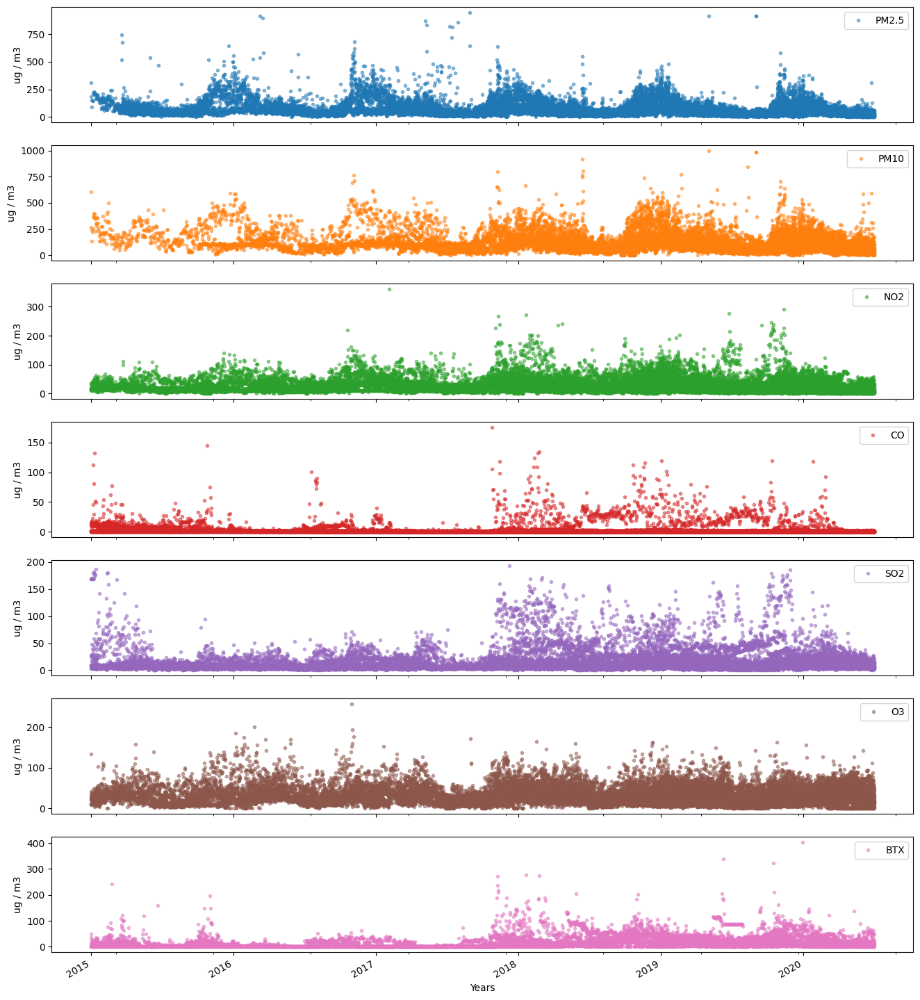

In [ ]:
city_day.set_index('Date',inplace=True)
axes = city_day[pollutants].plot(marker='.', alpha=0.5, linestyle='None', figsize=(16, 20), subplots=True)
for ax in axes:

    ax.set_xlabel('Years')
    ax.set_ylabel('ug / m3')

In [ ]:
def max_polluted_city(pollutant):
    x1 = city_day[[pollutant,'City']].groupby(["City"]).mean().sort_values(by=pollutant,ascending=False).reset_index()
    x1[pollutant] = round(x1[pollutant],2)
    return x1[:10].style.background_gradient(cmap='OrRd')

In [ ]:
from IPython.display import display_html
def display_side_by_side(*args):
    html_str = ''
    for df in args:
        html_str += df.to_html()
    display_html(html_str.replace('table', 'table style="display:inline"'), raw=True)

In [ ]:
pm2_5 = max_polluted_city('PM2.5')
pm10 = max_polluted_city('PM10')
no2 = max_polluted_city('NO2')
so2 = max_polluted_city('SO2')
co = max_polluted_city('CO')
btx = max_polluted_city('BTX')


display_side_by_side(pm2_5,pm10,no2,so2,co,btx)

,City,PM2.5
0,Patna,123.500000
1,Delhi,117.200000
2,Gurugram,117.100000
3,Lucknow,109.710000
4,Ahmedabad,67.850000
5,Kolkata,64.360000
6,Jorapokhar,64.230000
7,Brajrajnagar,64.060000
8,Guwahati,63.690000
9,Talcher,61.410000


In [ ]:
df1 = df.copy()
df1['PM2.5']=df1['PM2.5'].fillna((df1['PM2.5'].median()))
df1['PM10']=df1['PM10'].fillna((df1['PM10'].median()))
df1['NO']=df1['NO'].fillna((df1['NO'].median()))
df1['NO2']=df1['NO2'].fillna((df1['NO2'].median()))
df1['NOx']=df1['NOx'].fillna((df1['NOx'].median()))
df1['NH3']=df1['NH3'].fillna((df1['NH3'].median()))
df1['CO']=df1['CO'].fillna((df1['CO'].median()))
df1['SO2']=df1['SO2'].fillna((df1['SO2'].median()))
df1['O3']=df1['O3'].fillna((df1['O3'].median()))
df1['Benzene']=df1['Benzene'].fillna((df1['Benzene'].median()))
df1['Toluene']=df1['Toluene'].fillna((df1['Toluene'].median()))
df1['Xylene']=df1['Xylene'].fillna((df1['Xylene'].median()))
df1['AQI']=df1['AQI'].fillna((df1['AQI'].median()))
df1['AQI_Bucket']=df1['AQI_Bucket'].fillna('Moderate')

In [ ]:
df1['City'].unique()

array(['Ahmedabad', 'Aizawl', 'Amaravati', 'Amritsar', 'Bengaluru',
       'Bhopal', 'Brajrajnagar', 'Chandigarh', 'Chennai', 'Coimbatore',
       'Delhi', 'Ernakulam', 'Gurugram', 'Guwahati', 'Hyderabad',
       'Jaipur', 'Jorapokhar', 'Kochi', 'Kolkata', 'Lucknow', 'Mumbai',
       'Patna', 'Shillong', 'Talcher', 'Thiruvananthapuram',
       'Visakhapatnam'], dtype=object)

In [ ]:
df1['City'].value_counts()


,count
City,
Ahmedabad,2009
Delhi,2009
Mumbai,2009
Bengaluru,2009
Lucknow,2009
Chennai,2009
Hyderabad,2006
Patna,1858
Gurugram,1679


In [ ]:
df1['Pollution'] = df1['PM2.5']+df1['PM10']+df1['NO']+df1['NO2']+df1['NOx']+df1['NH3']+df1['CO']+df1['SO2']+df1['O3']+df1['Benzene']+df1['Toluene']+df1['Xylene']

In [ ]:
print(df1['Pollution'])

0        358.33
1        265.75
2        329.12
3        270.19
4        370.80
          ...  
29526    178.07
29527    203.18
29528    190.54
29529    167.41
29530    152.26
Name: Pollution, Length: 29531, dtype: float64


In [ ]:
!pip uninstall -y pandas-profiling


In [ ]:
!pip install ydata-profiling


  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 18.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 37.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 86.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=0ebe94276ffd1e0b1e89e209bc60f82ab9106cff920875b8472530242678f56f
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport


In [ ]:
data = pd.read_csv('https://github.com/Kavyagodugu/aqi-dataset/blob/main/city_day.csv?raw=true')
data

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory


In [ ]:
profile = data.profile_report(title="EDA", explorative = True)
profile.to_file(output_file="EDA.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

In [ ]:
print(df1)

                City       Date  PM2.5   PM10     NO    NO2    NOx    NH3  \
0          Ahmedabad 2015-01-01  48.57  95.68   0.92  18.22  17.15  15.85   
1          Ahmedabad 2015-01-02  48.57  95.68   0.97  15.69  16.46  15.85   
2          Ahmedabad 2015-01-03  48.57  95.68  17.40  19.30  29.70  15.85   
3          Ahmedabad 2015-01-04  48.57  95.68   1.70  18.48  17.97  15.85   
4          Ahmedabad 2015-01-05  48.57  95.68  22.10  21.42  37.76  15.85   
...              ...        ...    ...    ...    ...    ...    ...    ...   
29526  Visakhapatnam 2020-06-27  15.02  50.94   7.68  25.06  19.54  12.47   
29527  Visakhapatnam 2020-06-28  24.38  74.09   3.42  26.06  16.53  11.99   
29528  Visakhapatnam 2020-06-29  22.91  65.73   3.45  29.53  18.33  10.71   
29529  Visakhapatnam 2020-06-30  16.64  49.97   4.05  29.26  18.80  10.03   
29530  Visakhapatnam 2020-07-01  15.00  66.00   0.40  26.85  14.05   5.20   

          CO    SO2      O3  Benzene  Toluene  Xylene    AQI    AQI_Bucket 

In [ ]:
profile = df1.profile_report(title="EDA", explorative = True)
profile.to_file(output_file="EDA.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
from math import sqrt

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
def rmsle(real, predicted):
    sum=0.0
    for x in range(len(predicted)):
        if predicted[x]<0 or real[x]<0:
            continue
        p = np.log(predicted[x]+1)
        r = np.log(real[x]+1)
        sum = sum + (p - r)**2
    return ((sum/len(predicted))**0.5)[0]

In [ ]:
df1.to_csv("preprocessed_dataset.csv", index=False)

In [ ]:
from google.colab import files

# Save the file
df1.to_csv('/content/processed_data.csv', index=False)

# Download the file
files.download('/content/processed_data.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
df1 = df1.drop(columns=['Date'])

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
label_encoder = LabelEncoder()
df1['City'] = label_encoder.fit_transform(df1['City'])
df1['AQI_Bucket'] = label_encoder.fit_transform(df1['AQI_Bucket'])

In [ ]:
X = df1.drop(columns=['AQI'])
y = df1['AQI']

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.metrics import r2_score

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
def rmsle(y_true, y_pred):
    """
    Calculates Root Mean Squared Logarithmic Error (RMSLE) while handling zeros or negative values.
    """

    y_true = np.clip(y_true, 1e-10, None)
    y_pred = np.clip(y_pred, 1e-10, None)

    return sqrt(np.mean(np.square(np.log1p(y_pred) - np.log1p(y_true))))


In [ ]:
mlr = LinearRegression()
mlr.fit(X_train, y_train)

LinearRegression()

In [ ]:
mlr_y_predict = mlr.predict(X_test)

In [ ]:
rmse_mlr = sqrt(mean_squared_error(y_test, mlr_y_predict))
mae_mlr = mean_absolute_error(y_test, mlr_y_predict)
r2_mlr = r2_score(y_test, mlr_y_predict)
rmsle_mlr = rmsle(y_test, mlr_y_predict)


In [ ]:
print(f"Error Metrics for Test Data (Multiple Linear Regression):")
print(f"RMSE: {rmse_mlr}")
print(f"MAE: {mae_mlr}")
print(f"R² Score: {r2_mlr}")
print(f"RMSLE: {rmsle_mlr}")

Error Metrics for Test Data (Multiple Linear Regression):
RMSE: 53.13848335877124
MAE: 32.09969760733159
R² Score: 0.8165770077088582
RMSLE: 0.30100683192483335


In [ ]:
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
def rmsle(y_true, y_pred):
    """
    Calculates Root Mean Squared Logarithmic Error (RMSLE) while handling zeros or negative values.
    """

    y_true = np.clip(y_true, 1e-10, None)
    y_pred = np.clip(y_pred, 1e-10, None)

    return sqrt(np.mean(np.square(np.log1p(y_pred) - np.log1p(y_true))))


In [ ]:
poly = PolynomialFeatures(degree=2)
X_poly_train = poly.fit_transform(X_train)
X_poly_test = poly.transform(X_test)

In [ ]:
poly_reg = LinearRegression()
poly_reg.fit(X_poly_train, y_train)

LinearRegression()

In [ ]:
poly_y_predict = poly_reg.predict(X_poly_test)

In [ ]:
rmse_poly = sqrt(mean_squared_error(y_test, poly_y_predict))
mae_poly = mean_absolute_error(y_test, poly_y_predict)
r2_poly = r2_score(y_test, poly_y_predict)
rmsle_poly = rmsle(y_test, poly_y_predict)


In [ ]:
print(f"Error Metrics for Test Data (Polynomial Regression):")
print(f"RMSE: {rmse_poly}")
print(f"MAE: {mae_poly}")
print(f"R² Score: {r2_poly}")
print(f"RMSLE: {rmsle_poly}")

Error Metrics for Test Data (Polynomial Regression):
RMSE: 43.25592405608961
MAE: 24.49415154131114
R² Score: 0.8784579233414705
RMSLE: 0.24988870315416004


In [ ]:
import matplotlib.pyplot as plt

In [ ]:


# Multiple Linear Regression Predictions
mlr_y_predict = mlr.predict(X_test)

# Polynomial Regression Predictions
poly_y_predict = poly_reg.predict(X_poly_test)

In [ ]:
plt.figure(figsize=(18, 5))


<Figure size 1800x500 with 0 Axes>

<Figure size 1800x500 with 0 Axes>

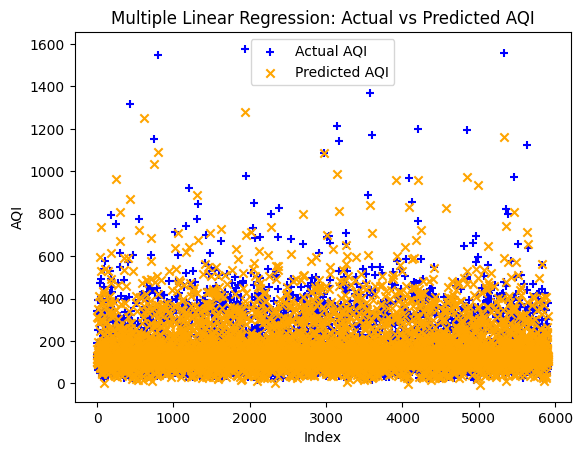

In [ ]:
plt.scatter(range(len(y_test)), y_test, c='blue', marker='+', label='Actual AQI')
plt.scatter(range(len(mlr_y_predict)), mlr_y_predict, c='orange', marker='x', label='Predicted AQI')
plt.xlabel('Index')
plt.ylabel('AQI')
plt.title('Multiple Linear Regression: Actual vs Predicted AQI')
plt.legend()
plt.show()


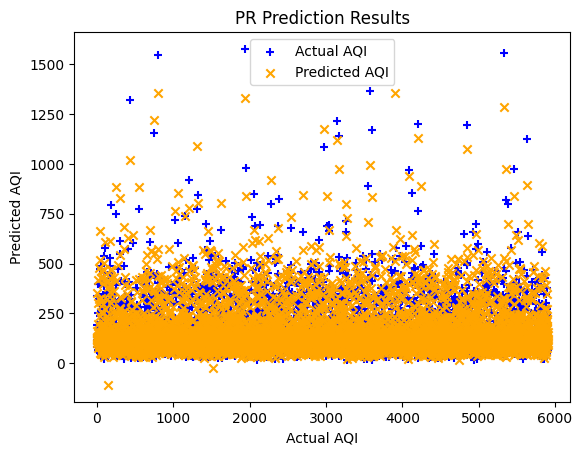

In [ ]:
plt.scatter(range(len(y_test)), y_test, c='blue', marker='+', label='Actual AQI')
plt.scatter(range(len(poly_y_predict)), poly_y_predict, c='orange', marker='x', label='Predicted AQI')
plt.xlabel('Actual AQI')
plt.ylabel('Predicted AQI')
plt.title('PR Prediction Results')
plt.legend()
plt.show()

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
dec_tree = DecisionTreeRegressor(random_state = 0)
dec_tree.fit(X_train,y_train)

dt_y_predict = dec_tree.predict(X_test)

In [ ]:
rmse_dt = sqrt(mean_squared_error(y_test, dt_y_predict))
mae_dt = mean_absolute_error(y_test, dt_y_predict)
r2_dt = r2_score(y_test,dt_y_predict)
rmsle_dt = rmsle(y_test,dt_y_predict)

print(f"Error Metrics for Test data (DT):\n rmse_dt: {rmse_dt} \n mae_dt: {mae_dt}\n r2_dt: {r2_dt}\n rmsle_dt: {rmsle_dt}");

Error Metrics for Test data (DT):
 rmse_dt: 35.673681068706934 
 mae_dt: 16.807755357887213
 r2_dt: 0.9173331641671039
 rmsle_dt: 0.15329980308959684


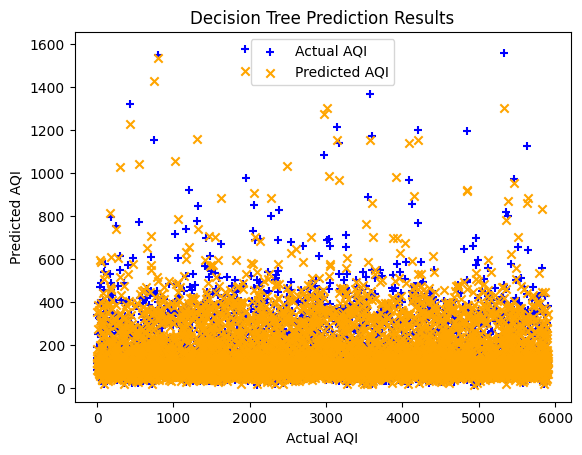

In [ ]:
plt.scatter(range(len(y_test)), y_test, c='blue', marker='+', label='Actual AQI')
plt.scatter(range(len(dt_y_predict)), dt_y_predict, c='orange', marker='x', label='Predicted AQI')
plt.xlabel('Actual AQI')
plt.ylabel('Predicted AQI')
plt.title('Decision Tree Prediction Results')
plt.legend()
plt.show()

In [ ]:
rt_reg = RandomForestRegressor(n_estimators = 500, random_state = 0)
rt_reg.fit(X_train,y_train)

rt_y_predict = rt_reg.predict(X_test)

In [ ]:
rmse_rt = sqrt(mean_squared_error(y_test, rt_y_predict))
mae_rt = mean_absolute_error(y_test, rt_y_predict)
r2_rt = r2_score(y_test,rt_y_predict)
rmsle_rt = rmsle(y_test,rt_y_predict)

print(f"Error Metrics for Test data:\n rmse_rt: {rmse_rt} \n mae_rt: {mae_rt}\n r2_rt: {r2_rt}\n rmsle_rt: {rmsle_rt}");

Error Metrics for Test data:
 rmse_rt: 26.926857223254608 
 mae_rt: 12.503943673938542
 r2_rt: 0.9529015299905536
 rmsle_rt: 0.11087799664986918


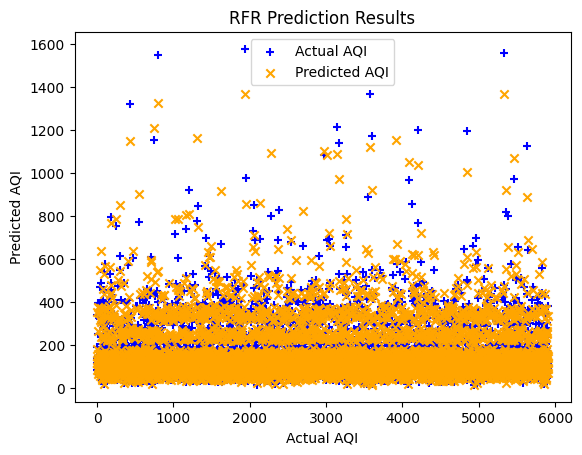

In [ ]:
plt.scatter(range(len(y_test)), y_test, c='blue', marker='+', label='Actual AQI')
plt.scatter(range(len(rt_y_predict)), rt_y_predict, c='orange', marker='x', label='Predicted AQI')
plt.xlabel('Actual AQI')
plt.ylabel('Predicted AQI')
plt.title('RFR Prediction Results')
plt.legend()
plt.show()

In [ ]:
from sklearn.svm import SVR

In [ ]:
sc_x = StandardScaler()
sc_y = StandardScaler()
x_train_svr = sc_x.fit_transform(X_train)
y_train_svr = sc_y.fit_transform(y_train.values.reshape(-1, 1)).ravel()

svr_reg = SVR(kernel='rbf')
svr_reg.fit(x_train_svr,y_train_svr)

svr_y_predict = sc_y.inverse_transform(svr_reg.predict(sc_x.transform(X_test)).reshape(1,-1))

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Ensure `svr_y_predict` is 1D
svr_y_predict = svr_y_predict.ravel()

# Ensure `y_test` is also 1D
if isinstance(y_test, pd.DataFrame):
    y_test = y_test.values.ravel()

# Compute error metrics
rmse_svr = np.sqrt(mean_squared_error(y_test, svr_y_predict))
mae_svr = mean_absolute_error(y_test, svr_y_predict)
r2_svr = r2_score(y_test, svr_y_predict)

# Define RMSLE if not already
from sklearn.metrics import mean_squared_log_error
def rmsle(y_true, y_pred):
    return np.sqrt(mean_squared_log_error(y_true, y_pred))

rmsle_svr = rmsle(y_test, svr_y_predict)

# Print results
print(f"Error Metrics for Test Data:\n rmse_svr: {rmse_svr} \n mae_svr: {mae_svr}\n r2_svr: {r2_svr}\n rmsle_svr: {rmsle_svr}")


Error Metrics for Test Data:
 rmse_svr: 41.16356759059295 
 mae_svr: 17.43748070490002
 r2_svr: 0.8899318976249785
 rmsle_svr: 0.16550515683594422


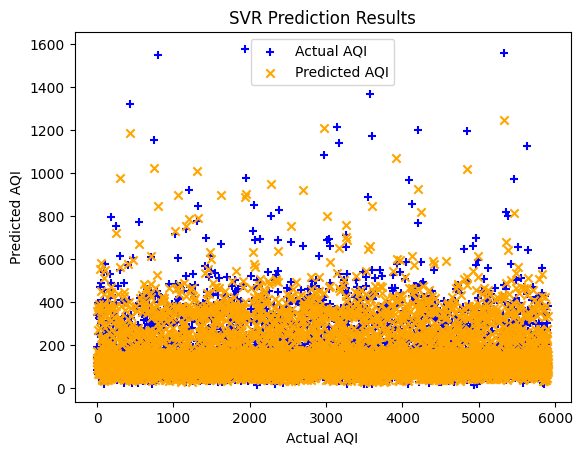

In [ ]:
plt.scatter(range(len(y_test)), y_test, c='blue', marker='+', label='Actual AQI')
plt.scatter(range(len(svr_y_predict.T)), svr_y_predict.T, c='orange', marker='x', label='Predicted AQI')
plt.xlabel('Actual AQI')
plt.ylabel('Predicted AQI')
plt.title('SVR Prediction Results')
plt.legend()
plt.show()

In [ ]:
print("evaluating on testing data:")
print("----------------------------------------")
print("models\tR^2\tRMSE\tMAE\tRMSLE")
print("MLR\t{0:.4f}\t{1:.4f}\t{2:.4f}\t{3:.4f}".format(r2_mlr,rmse_mlr,mae_mlr,rmsle_mlr))
print("PR\t{0:.2f}\t{1:.2f}\t{2:.3f}\t{3:.4f}".format(r2_poly,rmse_poly,mae_poly,rmsle_poly))
print("DTR\t{0:.4f}\t{1:.4f}\t{2:.4f}\t{3:.4f}".format(r2_dt,rmse_dt,mae_dt,rmsle_dt))
print("RFR\t{0:.4f}\t{1:.4f}\t{2:.4f}\t{3:.4f}".format(r2_rt,rmse_rt,mae_rt,rmsle_rt))
print("SVR\t{0:.4f}\t{1:.4f}\t{2:.4f}\t{3:.4f}".format(r2_svr,rmse_svr,mae_svr,rmsle_svr))

evaluating on testing data:
----------------------------------------
models	R^2	RMSE	MAE	RMSLE
MLR	0.8166	53.1385	32.0997	0.3010
PR	0.88	43.26	24.494	0.2499
DTR	0.9173	35.6737	16.8078	0.1533
RFR	0.9529	26.9269	12.5039	0.1109
SVR	0.8899	41.1636	17.4375	0.1655


In [ ]:
import sqlite3

# Connect to SQLite Database
conn = sqlite3.connect("contacts.db")
cursor = conn.cursor()


cursor.execute("""
    CREATE TABLE  mail (
        city TEXT,
        email TEXT,
        predicted_aqi REAL
    )
""")
conn.commit()

In [ ]:
import random

In [ ]:
emails = [
    "b191149@rgukt.ac.in",
    "godugukavya2@gmail.com",
    "kavyasrigodugu@gmail.com",
    "b192271@rgukt.ac.in",
    "baddushivani@gmail.com",
    "shivani79959@gmail.com",
    "b192418@rgukt.ac.in",
    "bandariakhilab@gmail.com"
]

# List of cities
cities = [
    "Aizawl", "Mumbai", "Brajrajnagar", "Chennai", "Patna", "Hyderabad",
    "Ahmedabad", "Amritsar", "Coimbatore", "Guwahati", "Bengaluru", "Ernakulam",
    "Jorapokhar", "Talcher", "Chandigarh", "Shillong", "Kochi", "Thiruvananthapuram",
    "Gurugram", "Delhi", "Jaipur", "Visakhapatnam", "Bhopal", "Kolkata", "Lucknow",
    "Amaravati"
]

cities_emails = [(city, random.choice(emails), pred) for city, pred in zip(cities, rt_y_predict)]

# Insert Data into Database
cursor.executemany("""
    INSERT INTO mail (city, email, predicted_aqi) VALUES (?, ?, ?)
""", cities_emails)
conn.commit()

print(f"Database created with city email contacts and predicted AQI!")

# Close connection
conn.close()

Database created with city email contacts and predicted AQI!


In [ ]:
file_path = "contacts.db"

In [ ]:
import smtplib
import sqlite3
from email.mime.text import MIMEText
from email.mime.multipart import MIMEMultipart

# Database connection
#file_path = "your_database.db"  # Replace with actual DB file path
conn = sqlite3.connect(file_path)
cursor = conn.cursor()

# Query to get the city, email, and predicted_aqi from the database
cursor.execute("SELECT city, email, predicted_aqi FROM mail")
rows = cursor.fetchall()

# Email setup (use your email and app password)
sender_email = "kavyasrigodugu@gmail.com"  # Replace with your email
sender_password = "wici mmog koci zcla"  # Use an app password if 2FA is enabled
smtp_server = "smtp.gmail.com"
smtp_port = 587

# AQI categories and thresholds
aqi_categories = {
    "Good": (0, 50, "Air quality is considered satisfactory, and air pollution poses little or no risk."),
    "Moderate": (51, 100, "Air quality is acceptable, but some pollutants may affect sensitive individuals."),
    "Unhealthy for Sensitive Groups": (101, 150, "Children, elderly, and people with respiratory conditions should limit outdoor activities."),
    "Unhealthy": (151, 200, "Everyone may experience health effects; sensitive groups should avoid outdoor exertion."),
    "Very Unhealthy": (201, 300, "Health alert: everyone may experience serious effects."),
    "Hazardous": (301, float('inf'), "Health warning: emergency conditions. Everyone is more likely to be affected.")
}

# Function to determine AQI category
def get_aqi_category(aqi):
    for category, (low, high, message) in aqi_categories.items():
        if low <= aqi <= high:
            return category, message
    return "Unknown", "No information available."

# Loop through the rows and send email based on AQI category
for row in rows:
    city, email, predicted_aqi = row
    category, health_advice = get_aqi_category(predicted_aqi)

    # Compose email message
    subject = f"AQI Alert for {city} - {category} Air Quality"
    body = f"Hello,\n\nThe predicted AQI for {city} is {predicted_aqi:.2f}, which falls under the '{category}' category.\n\n{health_advice}\n\nPlease take necessary precautions.\n\nBest regards,\nAir Quality Monitoring Team"

    # Create the email message
    message = MIMEMultipart()
    message['From'] = sender_email
    message['To'] = email
    message['Subject'] = subject
    message.attach(MIMEText(body, 'plain'))

    try:
        # Set up the SMTP server and send the email
        server = smtplib.SMTP(smtp_server, smtp_port)
        server.starttls()  # Secure connection
        server.login(sender_email, sender_password)
        server.sendmail(sender_email, email, message.as_string())
        server.quit()  # Close the connection

        print(f"✅ Email sent to {email} for city {city} with predicted AQI: {predicted_aqi:.2f} (Category: {category})")

    except Exception as e:
        print(f"❌ Error sending email to {email} for city {city}: {e}")

# Close the database connection
conn.close()


✅ Email sent to b192418@rgukt.ac.in for city Aizawl with predicted AQI: 118.00 (Category: Unhealthy for Sensitive Groups)
✅ Email sent to b191149@rgukt.ac.in for city Mumbai with predicted AQI: 118.00 (Category: Unhealthy for Sensitive Groups)
✅ Email sent to kavyasrigodugu@gmail.com for city Brajrajnagar with predicted AQI: 130.40 (Category: Unhealthy for Sensitive Groups)
✅ Email sent to baddushivani@gmail.com for city Chennai with predicted AQI: 180.88 (Category: Unhealthy)
✅ Email sent to baddushivani@gmail.com for city Patna with predicted AQI: 352.64 (Category: Hazardous)
✅ Email sent to b192271@rgukt.ac.in for city Hyderabad with predicted AQI: 82.57 (Category: Moderate)
✅ Email sent to b191149@rgukt.ac.in for city Ahmedabad with predicted AQI: 117.99 (Category: Unhealthy for Sensitive Groups)
✅ Email sent to godugukavya2@gmail.com for city Amritsar with predicted AQI: 141.24 (Category: Unhealthy for Sensitive Groups)
✅ Email sent to bandariakhilab@gmail.com for city Coimbatore 